In [287]:
import logging
import s3fs
import numpy as np
import os.path as op
import os
import plotly.express as px
from collections import OrderedDict
import plotly.graph_objs as go
import plotly
import dipy.tracking.streamlinespeed as dps
from palettable.tableau import Tableau_20
import AFQ.api as api
import nibabel as nib
import tempfile
import imageio as io
import IPython.display as display

In [284]:
def afq_prek_api(subject):    
    logging.basicConfig(level=logging.INFO)
    log = logging.getLogger(__name__)  

    fs = s3fs.S3FileSystem()
    
    sub_prefix = f"sub-"
        
    dwi_dir = f'prek-diffusion/derivatives/sub-{subject}/dtiInit_ses-pre'
    dmri_prep_dir = op.join(op.expanduser('~'), 'AFQ_data', 'prek-diffusion/dmri_prep')

    prek_fdata_src = op.join(dwi_dir, f"sub-{subject}_ses-pre_acq-b1500_dwi_aligned_trilin.nii.gz")
    prek_fbval_src = op.join(dwi_dir, f"sub-{subject}_ses-pre_acq-b1500_dwi_aligned_trilin.bvals")
    prek_fbvec_src = op.join(dwi_dir, f"sub-{subject}_ses-pre_acq-b1500_dwi_aligned_trilin.bvecs")
    
    prek_fdata = f"{dmri_prep_dir}/sub-{subject}/dtiInit_ses-pre/dwi/dwi_aligned_trilin.nii.gz"
    prek_fbval = f"{dmri_prep_dir}/sub-{subject}/dtiInit_ses-pre/dwi/dwi_aligned_trilin.bvals"
    prek_fbvec = f"{dmri_prep_dir}/sub-{subject}/dtiInit_ses-pre/dwi/dwi_aligned_trilin.bvecs"
    
    anat_dir = f'prek-diffusion/derivatives/sub-{subject}/freesurfer/mri'

    if not op.exists(prek_fdata):
        fs.get(prek_fdata_src, prek_fdata)
        fs.get(prek_fbval_src, prek_fbval)
        fs.get(prek_fbvec_src, prek_fbvec)

        fs.get(op.join(anat_dir, f"aparc+aseg.nii.gz"), f"{dmri_prep_dir}/sub-{subject}/dtiInit_ses-pre/anat/aparc+aseg.nii.gz")

    wm_labels=[250, 251, 252, 253, 254, 255, 41, 2, 16, 77]
    b0_threshold = 50

    tracking_params = {"n_seeds": 2, "directions": 'det', "stop_threshold": 0.2}
    segmentation_params = {"prob_threshold": 10, "b0_threshold": b0_threshold}
    clean_params = {"clean_rounds": 1}
    
    # uncomment this to download relevant files instead of generating them
    # fs.get("prek-diffusion/derivatives_fa/afq/sub1110/sess", op.join(op.expanduser('~'), 'AFQ_data/prek-diffusion/afq/sub-1110/dtiInit_ses-pre'), recursive=True)

    myafq = api.AFQ(dmri_prep_dir,
                    dwi_folder="dwi",
                    dwi_file="dwi*", 
                    anat_folder="anat",
                    wm_labels=wm_labels,
                    use_prealign=False,
                    sub_prefix=sub_prefix,
                    b0_threshold=b0_threshold,

                    tracking_params=tracking_params,
                    segmentation_params=segmentation_params,
                    clean_params=clean_params)

    myafq.export_bundles()
    return myafq

In [3]:
myafq = afq_prek_api(1110) # make example bundles

INFO:botocore.credentials:Found credentials in shared credentials file: ~/.aws/credentials
INFO:dipy.data.fetcher:Dataset is already in place. If you want to fetch it again please first remove the folder /Users/john/AFQ_data/templates 
INFO:dipy.data.fetcher:Dataset is already in place. If you want to fetch it again please first remove the folder /Users/john/AFQ_data/callosum_templates 
INFO:AFQ.api:Saving /Users/john/AFQ_data/prek-diffusion/afq/sub-1110/dtiInit_ses-pre/clean_bundles/dwi_aligned_trilin_space-RASMM_model-DTI_desc-det-AFQ-ATR_R_tractography.trk
INFO:AFQ.api:Saving /Users/john/AFQ_data/prek-diffusion/afq/sub-1110/dtiInit_ses-pre/clean_bundles/dwi_aligned_trilin_space-RASMM_model-DTI_desc-det-AFQ-ATR_L_tractography.trk
INFO:AFQ.api:Saving /Users/john/AFQ_data/prek-diffusion/afq/sub-1110/dtiInit_ses-pre/clean_bundles/dwi_aligned_trilin_space-RASMM_model-DTI_desc-det-AFQ-CGC_R_tractography.trk
INFO:AFQ.api:Saving /Users/john/AFQ_data/prek-diffusion/afq/sub-1110/dtiInit_ses-p

In [4]:

tableau_20_rgb = np.array(Tableau_20.colors) / 255 -  0.0001
color_dict = OrderedDict({"ATR_L": tableau_20_rgb[0],
                          "ATR_R": tableau_20_rgb[1],
                          "CST_L": tableau_20_rgb[2],
                          "CST_R": tableau_20_rgb[3],
                          "CGC_L": tableau_20_rgb[4],
                          "CGC_R": tableau_20_rgb[5],
                          "HCC_L": tableau_20_rgb[6],
                          "HCC_R": tableau_20_rgb[7],
                          "FP": tableau_20_rgb[8],
                          "FA": tableau_20_rgb[9],
                          "IFO_L": tableau_20_rgb[10],
                          "IFO_R": tableau_20_rgb[11],
                          "ILF_L": tableau_20_rgb[12],
                          "ILF_R": tableau_20_rgb[13],
                          "SLF_L": tableau_20_rgb[14],
                          "SLF_R": tableau_20_rgb[15],
                          "UNC_L": tableau_20_rgb[16],
                          "UNC_R": tableau_20_rgb[17],
                          "ARC_L": tableau_20_rgb[18],
                          "ARC_R": tableau_20_rgb[19]})

In [223]:
def _inline_interact(figure, show, show_inline):
    """
    Helper function to reuse across viz functions
    """
    if show:
        plotly.offline.plot(figure)

    if show_inline:
        plotly.offline.iplot(figure)

    return figure

In [5]:
def _color_arr2str(color_arr, opacity=1.0):
    return f"rgba({color_arr[0]}, {color_arr[1]}, {color_arr[2]}, {opacity})"

In [6]:
def _draw_streamlines(figure, sls, color, name, n_points=100):
    x_pts = []
    y_pts = []
    z_pts = []
    
    for sl in sls:
        # resample streamline to n_points
        if sl.shape[0] > n_points:
            sl = dps.set_number_of_points(sl, n_points)

        # add sl to lines
        x_pts.extend(sl[:, 0])
        x_pts.append(None) # don't draw between streamlines
        y_pts.extend(sl[:, 1])
        y_pts.append(None)
        z_pts.extend(sl[:, 2])
        z_pts.append(None)

    figure.add_trace(
        go.Scatter3d(
            x=pts[0],
            y=pts[1],
            z=pts[2],
            mode='lines',
            name=name,
            line=dict(
                width=1,
                color=_color_arr2str(color),
            )
        )
    )

In [7]:
def visualize_bundles(trk, affine=None, bundle_dict=None, bundle=None,
                      colors=None, figure=None, background=(1, 1, 1),
                      resample=100, show=False, show_inline=False):
    """
    Visualize bundles in 3D using VTK

    Parameters
    ----------
    trk : str, list, or Streamlines
        The streamline information

    affine : ndarray, optional
       An affine transformation to apply to the streamlines before
       visualization. Default: no transform.

    bundle_dict : dict, optional
        Keys are names of bundles and values are dicts that should include
        a key `'uid'` with values as integers for selection from the trk
        metadata. Default: bundles are either not identified, or identified
        only as unique integers in the metadata.

    bundle : str or int, optional
        The name of a bundle to select from among the keys in `bundle_dict`
        or an integer for selection from the trk metadata.

    colors : dict or list
        If this is a dict, keys are bundle names and values are RGB tuples.
        If this is a list, each item is an RGB tuple. Defaults to a list
        with Tableau 20 RGB values

    background : tuple, optional
        RGB values for the background. Default: (1, 1, 1), which is white
        background.

    scene : fury Scene object, optional
        If provided, the visualization will be added to this Scene. Default:
        Initialize a new Scene.

    show : bool
        Whether to provide an interactive html file.
        Default: False

    show_inline : bool
        Whether to embed the visualization inline in a notebook. Only works
        in the notebook context. Default: False.

    Returns
    -------
    Fury Scene object
    """
    if isinstance(trk, str):
        trk = nib.streamlines.load(trk)
        tg = trk.tractogram
    else:
        # Assume these are streamlines (as list or Streamlines object):
        tg = nib.streamlines.Tractogram(trk)

    if affine is not None:
        tg = tg.apply_affine(np.linalg.inv(affine))

    streamlines = tg.streamlines

    if figure is None:
        figure = go.Figure()

    figure.update_layout(plot_bgcolor=f"rgba(0,0,0,0)")
        
    if colors is None:
        # Use the color dict provided
        colors = color_dict

    def _bundle_selector(bundle_dict, colors, b):
        """Helper function """
        b_name = str(b)
        if bundle_dict is None:
            # We'll choose a color from a rotating list:
            if isinstance(colors, list):
                color = colors[np.mod(len(colors), int(b))]
            else:
                color_list = colors.values()
                color = color_list[np.mod(len(colors), int(b))]
        else:
            # We have a mapping from UIDs to bundle names:
            for b_name_iter, b_iter in bundle_dict.items():
                if b_iter['uid'] == b:
                    b_name = b_name_iter
                    break
            color = colors[b_name]
        return color, b_name

    if list(tg.data_per_streamline.keys()) == []:
        # There are no bundles in here:
        streamlines = list(streamlines)
        # Visualize all the streamlines with directionally assigned RGB:
        _draw_streamlines(figure, sl, [0.5, 0.5, 0.5], "all_bundles", n_points=resample)
        

    else:
        # There are bundles:
        if bundle is None:
            # No selection: visualize all of them:
            
            for b in np.unique(tg.data_per_streamline['bundle']):
                idx = np.where(tg.data_per_streamline['bundle'] == b)[0]
                these_sls = list(streamlines[idx])
                color, b_name = _bundle_selector(bundle_dict, colors, b)
                _draw_streamlines(figure, these_sls, color, b_name, n_points=resample)

        else:
            # Select just one to visualize:
            if isinstance(bundle, str):
                # We need to find the UID:
                uid = bundle_dict[bundle]['uid']
            else:
                # It's already a UID:
                uid = bundle

            idx = np.where(tg.data_per_streamline['bundle'] == uid)[0]
            these_sls = list(streamlines[idx])
            color, b_name = _bundle_selector(bundle_dict, colors, uid)
            _draw_streamlines(figure, these_sls, color, b_name, n_points=resample)

    return _inline_interact(figure, show, show_inline)

In [154]:
# resample these to reduce lag
figure = visualize_bundles(myafq.get_clean_bundles()[0], bundle_dict=myafq.bundle_dict, resample=100)

In [155]:
directory = op.join(op.expanduser('~'), 'AFQ_data/prek-diffusion/afq/sub-1110/dtiInit_ses-pre')
plotly.offline.plot(figure, filename=op.join(directory, "test_plotly.html"))

'/Users/john/AFQ_data/prek-diffusion/afq/sub-1110/dtiInit_ses-pre/test_plotly.html'

In [156]:
figure.layout.scene

layout.Scene()

In [267]:
def _draw_roi(figure, roi, color, opacity):
    roi = np.where(roi==1)
    figure.add_trace(
        go.Scatter3d(
            x=roi[0],
            y=roi[1],
            z=roi[2],
            marker=dict(color=_color_arr2str(color, opacity=opacity)),
            line=dict(color=f"rgba(0,0,0,0)")
        )
    )

In [268]:
def visualize_roi(roi, affine_or_mapping=None, static_img=None,
                  roi_affine=None, static_affine=None, reg_template=None,
                  figure=None, color=np.array([0.9999, 0, 0]), opacity=1.0,
                  show=False, show_inline=False):
    """
    Render a region of interest into a VTK viz as a volume
    """
    if not isinstance(roi, np.ndarray):
        if isinstance(roi, str):
            roi = nib.load(roi).get_fdata()
        else:
            roi = roi.get_fdata()

    if affine_or_mapping is not None:
        if isinstance(affine_or_mapping, np.ndarray):
            # This is an affine:
            if (static_img is None or roi_affine is None
                    or static_affine is None):
                raise ValueError("If using an affine to transform an ROI, "
                                 "need to also specify all of the following",
                                 "inputs: `static_img`, `roi_affine`, ",
                                 "`static_affine`")
            roi = reg.resample(roi, static_img, roi_affine, static_affine)
        else:
            # Assume it is  a mapping:
            if (isinstance(affine_or_mapping, str)
                    or isinstance(affine_or_mapping, nib.Nifti1Image)):
                if reg_template is None or static_img is None:
                    raise ValueError(
                        "If using a mapping to transform an ROI, need to ",
                        "also specify all of the following inputs: ",
                        "`reg_template`, `static_img`")
                affine_or_mapping = reg.read_mapping(affine_or_mapping,
                                                     static_img,
                                                     reg_template)

            roi = auv.patch_up_roi(affine_or_mapping.transform_inverse(
                                   roi,
                                   interpolation='nearest')).astype(bool)

    if figure is None:
        figure = go.Figure()

    figure.update_layout(plot_bgcolor=f"rgba(0,0,0,0)")

    _draw_roi(figure, roi, color, opacity)
    
    return _inline_interact(figure, show, show_inline)

In [273]:
figure = visualize_roi(myafq._export_rois(myafq.data_frame.iloc[0])['SLF_R'][0], opacity=0.5)

In [274]:
figure = visualize_bundles(
    myafq.get_clean_bundles()[0],
    affine=myafq.get_dwi_affine()[0],
    bundle_dict=myafq.bundle_dict,
    bundle=myafq.bundle_dict['SLF_R']['uid'],
    figure=figure)

In [291]:
#plotly.offline.iplot(figure)

In [276]:
# import dash
# import dash_core_components as dcc
# import dash_html_components as html
# from jupyter_dash import JupyterDash

# # df = px.data.gapminder().query("country=='Canada'")
# # figure = px.line(df, x="year", y="lifeExp", title='Life expectancy in Canada')

# app = JupyterDash()
# app.layout = html.Div([
#     dcc.Graph(figure=figure)
# ])

# app.run_server(mode="external")  # use_reloader=False, Turn off reloader if inside Jupyter
# # TODO: all of our plots are too inefficient ... maybe we should think harder about what needs to be displayed

In [277]:
def stop_orca():
    plotly.io.orca.shutdown_server()

def create_gif(figure, file_name, n_frames=60, zoom=2.5, z_offset=0.5, auto_stop_orca=True):
    tdir = tempfile.gettempdir()
    
    for i in range(n_frames):
        theta = (i*6.28)/n_frames
        camera = dict(
            eye=dict(x = np.cos(theta)*zoom, y = np.sin(theta)*zoom, z = z_offset)
        )
        figure.update_layout(scene_camera=camera)
        figure.write_image(tdir + f"/tgif{i}.png")

    if auto_stop_orca:
        stop_orca()
    
    angles = []
    for i in range(n_frames):
        if i < 10:
            angle_fname = f"tgif{i}.png"
        elif i < 100:
            angle_fname = f"tgif{i}.png"
        else:
            angle_fname = f"tgif{i}.png"
        angles.append(io.imread(os.path.join(tdir, angle_fname)))

    io.mimsave(file_name, angles)


In [278]:
# requires pip install psutil, install orca (complicated) (remember to add to requirements)
# https://plotly.com/python/static-image-export/#install-orca-on-google-colab
create_gif(figure, "test_gif.gif") 

In [533]:
import enum
class Axes(enum.IntEnum):
    X = 0
    Y = 1
    Z = 2

def _draw_slice(figure, axis, volume, opacity=0.3, step=None, n_steps=0):
    if step is None:
        height = volume.shape[axis]//2
        visible = True
    else:
        height = (volume.shape[axis]*step)//n_steps
        visible = False

    if axis == Axes.X:
        X, Y, Z = np.mgrid[height:height+1, :volume.shape[1], :volume.shape[2]]
        values = 1-volume[height, :, :].flatten()
    elif axis == Axes.Y:
        X, Y, Z = np.mgrid[:volume.shape[0], height:height+1, :volume.shape[2]]
        values = 1-volume[:, height, :].flatten()
    elif axis == Axes.Z:
        X, Y, Z = np.mgrid[:volume.shape[0], :volume.shape[1], height:height+1]
        values = 1-volume[:, :, height].flatten()

    figure.add_trace(
        go.Isosurface(
            x=X.flatten(),
            y=Y.flatten(),
            z=Z.flatten(),
            value=values,
            colorscale='greys',
            surface_count=1,
            showscale=False,
            opacity=opacity,
            visible=visible
        )
    )
    
def _name_from_enum(axis):
    if axis == Axes.X:
        return "Coronal"
    elif axis == Axes.Y:
        return "Sagittal"
    elif axis == Axes.Z:
        return "Axial"

def _draw_slices(figure, axis, volume, opacity=0.3, sliders=[], n_steps=0, y_loc=0):
    if n_steps == 0:
        _draw_slice(figure, axis, volume, opacity=opacity)
    else:
        active = n_steps//2
        name = _name_from_enum(axis) + " Plane"
        steps = []
        for step in range(n_steps):
            _draw_slice(figure, axis, volume, opacity=opacity, step=step, n_steps=n_steps)
            
            step_dict = dict(
                method="update",
                args=[{"visible": [False] * n_steps}],
                label=""
            )

            step_dict["args"][0]["visible"][step] = True
            steps.append(step_dict)

        figure.data[-active].visible = True
        sliders.append(dict(
            active=active,
            currentvalue=dict(visible=True, prefix=name, xanchor='center'),
            pad=dict(t=50),
            steps=steps,
            y=y_loc,
            x=0.2,
            lenmode='fraction',
            len=0.6
        ))

In [534]:
def visualize_volume(volume, figure=None, show_x=True, show_y=True, show_z=True,
                     show=False, opacity=0.3, show_inline=False, slider_definition=0):
    """
    Visualize a volume
    """
    if isinstance(volume, str):
        volume = nib.load(volume).get_fdata()
    
    if figure is None:
        figure = go.Figure()

    figure.update_layout(plot_bgcolor=f"rgba(0,0,0,0)")
    sliders = []

    if show_x:
        _draw_slices(figure, Axes.X, volume, sliders=sliders, opacity=opacity, n_steps=slider_definition, y_loc=0)
    if show_y:
        _draw_slices(figure, Axes.Y, volume, sliders=sliders, opacity=opacity, n_steps=slider_definition, y_loc=-0.3)
    if show_z:
        _draw_slices(figure, Axes.Z, volume, sliders=sliders, opacity=opacity, n_steps=slider_definition, y_loc=-0.6)

    figure.update_layout(sliders=tuple(sliders))
    
    return _inline_interact(figure, show, show_inline)

In [535]:
figure = visualize_volume(myafq.get_dti_fa()[0], slider_definition=20) #known bug: sliders do not separate

In [536]:
plotly.offline.iplot(figure)

In [288]:
def visualize_gif_inline(fname, use_s3fs=False):
    if use_s3fs:
        fs = s3fs.S3FileSystem()
        tdir = tempfile.gettempdir()
        fname_remote = fname
        fname = op.join(tdir, "fig.gif")
        fs.get(fname_remote, fname)
    
    display.display(display.Image(fname))

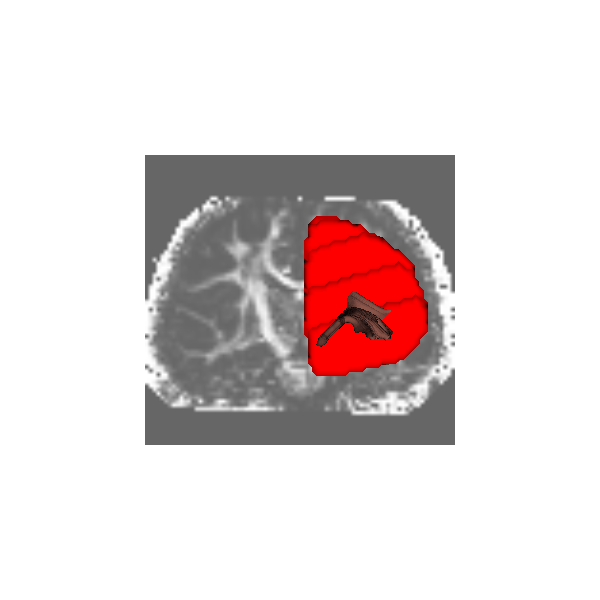

In [290]:
visualize_gif_inline("prek-diffusion/derivatives_mat/afq/sub1110/sess/viz_bundles/dwi_aligned_trilin_space-RASMM_model-DTI_desc-det-AFQ_IFO_L_viz.gif", use_s3fs=True)